In [1]:
from usgs import api
import requests 
import json
import utils
import pandas as pd
import json
import satellite_images as si
import os

In [18]:
URL = "https://earthexplorer.usgs.gov/inventory/json/v/1.4.0/"
username = ''
password = ''
data = {'jsonRequest':'{"username": "'  + username +  '", "password": "'  + password +  '", "authType": "EROS", "catalogId": "EE"}'}
resp  = requests.post(URL+ "login", data=data)
api_key = resp.json()["data"]
print(api_key)

None


In [3]:
def find_images_ee(api_key,start,end,lat,lng) :
    print(start,end,lat,lng)
    datasets = [
        'LANDSAT_ETM_C1'
    ]
    r= []
    for dataset in datasets : 
        results = api.search(  
                                dataset, 'EE',
                                start_date=start, end_date=end,
                                lat =lat, lng = lng , distance =100 ,
                                api_key=api_key
        )

        for scene in results['data']['results']:
            print(scene,'\n\n')
            r.append(scene)
    
    
    return r


In [4]:
biggest_fires = [  
                 ("2017-06-16T00:00:00.000Z", "2017-06-24T00:00:00.000Z" ,"39.95", "-8.233333" , "Pedrogão grande" ),
                 ("2018-08-03T00:00:00.000Z", "2018-08-17T00:00:00.000Z" ,"37.396944", "-8.588889" , "Serra de Monchique"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.116667", "-8.25" , "Lousã"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.05", "-7.95" , "Pampilhosa da Serra"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"39.747767", "-8.949711" , "Pinhal de Leiria"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.416667", "-7.7" , "Seia"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.488733", "-7.864655" , "Nelas"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.6", "-7.766667" , "Mangualde"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.491022", "-7.593597" , "Gouveia"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.360278", "-7.861667" , "Oliveira do Hospital"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.360345", "-8.029032" , "Tábua"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.302222", "-8.166111" , "Penacova"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.393056", "-8.233333" , "Mortágua"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.516667", "-8.083333" , "Tondela"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.269030", "-7.988616" , "Coja, Arganil"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.85", "-8.4" , "Vale de Cambra"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"39.800833", "-8.100278" , "Sertã"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"42.044444", "-8.443333" , "Monção"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.4", "-8.133333" , "Santa Comba Dão"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.2175", "-8.852778" , "Quiaios"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.316667", "-8.8" , "Tocha"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.433333", "-8.733333" , "Mira"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.55", "-8.683333" , "Vagos"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.6", "-8.666667" , "Ílhavo"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.433333", "-8" , "Carregal do Sal")
]
fires = pd.DataFrame(biggest_fires, 
         columns = ['datetime_from' , 'datetime_to', 'lat', 'lon' , "description"]
        )
indexs = [ 10 ]# , 11 , 14 , 24 , 5 , 9 ]
fires = fires.loc[indexs]
fires

,datetime_from,datetime_to,lat,lon,description
10,2017-10-13T00:00:00.000Z,2017-10-18T00:00:00.000Z,40.360345,-8.029032,Tábua


In [11]:
before2017={ }
for index, row in fires.iterrows():
    lat =float(row["lat"])
    lon =float(row["lon"])
    
    sensing_date_FROM = utils.iso_to_ymd( "2017-08-01T00:00:00.000Z" )
    sensing_date_TO = utils.iso_to_ymd(  "2017-09-01T00:00:00.000Z" )
    
    print('----------------------------------------->>>>>>>>>')
    r = find_images_ee(api_key,sensing_date_FROM,sensing_date_TO,lat,lon)
    before2017[index] = r
    print('\n\n')

----------------------------------------->>>>>>>>>
2017-08-01 2017-09-01 40.360345 -8.029032
{'acquisitionDate': '2017-08-26', 'startTime': '2017-08-26', 'endTime': '2017-08-26', 'spatialFootprint': {'type': 'Polygon', 'coordinates': [[[-9.79656, 39.68264], [-7.60909, 39.36484], [-7.07429, 40.95985], [-9.31312, 41.28522], [-9.79656, 39.68264]]]}, 'sceneBounds': '-9.79656,39.36484,-7.07429,41.28522', 'browseUrl': 'https://ims.cr.usgs.gov/browse/landsat_etm_c1/2017/204/032/LE07_L1TP_204032_20170826_20170921_01_T1.jpg', 'dataAccessUrl': 'https://earthexplorer.usgs.gov/order/process?dataset_name=LANDSAT_ETM_C1&ordered=LE72040322017238NSG00&node=INVSVC', 'downloadUrl': 'https://earthexplorer.usgs.gov/download/external/options/LANDSAT_ETM_C1/LE72040322017238NSG00/INVSVC/', 'entityId': 'LE72040322017238NSG00', 'displayId': 'LE07_L1TP_204032_20170826_20170921_01_T1', 'cloudCover': None, 'metadataUrl': 'https://earthexplorer.usgs.gov/metadata/xml/12267/LE72040322017238NSG00/', 'fgdcMetadataUrl'

### Save searches in json 

In [12]:
results = json.dumps(before2017)
f = open("./data/before2017.json","w")
f.write(results)
f.close()

### import saved searches

In [13]:
with open('./data/before2017.json') as json_file:
    before2017 = json.load(json_file)

## Downloading images

In [14]:
num_imgs = 0
downloadpath = "C:/Users/SimãoPauloLealBarbos/Downloads/"
for index in before2017 :
    if len(before2017[index])>0 :
        print('\n\n',index)
        for result in before2017[index] :
            si.download_landsat_img(index,result) # download img
            print("Donwloading!!")
            num_imgs+=1
            print(result["displayId"])
            browseUrl = result["browseUrl"]
            #si.show_img_from_url(browseUrl) # show natural color full img
            dataAccessUrl = result["dataAccessUrl"]
            downloadUrl = result["downloadUrl"]
            metadataUrl = result["metadataUrl"]
            downloads = utils.wait_for_downloads(300,1)
            outputpath = "../../Satellite_img_before_2017/" + index
            if (not os.path.isdir(outputpath)):
                os.mkdir(outputpath)
            command_to_move = "mv \"" +  downloadpath + downloads[0] + "\"  " + outputpath
            print("command_to_move",command_to_move)
            os.system( command_to_move )
            
#browseUrl natural img
#dataAccessUrl item basket EE
#downloadUrl url with several downloads options
print(num_imgs)



 10
Donwloading!!
LE07_L1TP_204032_20170826_20170921_01_T1
command_to_move mv "C:/Users/SimãoPauloLealBarbos/Downloads/LE07_L1TP_204032_20170826_20170921_01_T1.tar.gz"  ../../Satellite_img_before_2017/10
Donwloading!!
LE07_L1TP_203032_20170819_20170914_01_T1
command_to_move mv "C:/Users/SimãoPauloLealBarbos/Downloads/LE07_L1TP_203032_20170819_20170914_01_T1.tar.gz"  ../../Satellite_img_before_2017/10
Donwloading!!
LE07_L1TP_204032_20170810_20170905_01_T1
command_to_move mv "C:/Users/SimãoPauloLealBarbos/Downloads/LE07_L1TP_204032_20170810_20170905_01_T1.tar.gz"  ../../Satellite_img_before_2017/10
Donwloading!!
LE07_L1TP_203032_20170803_20170829_01_T1
command_to_move mv "C:/Users/SimãoPauloLealBarbos/Downloads/LE07_L1TP_203032_20170803_20170829_01_T1.tar.gz"  ../../Satellite_img_before_2017/10
4


# Unnzipping tar files and setting up downloaded images

In [15]:
si.unzipping_landsatfiles("../../Satellite_img_before_2017/")

['10']
4
4
4
4


# Visualizing images

In [16]:
indexs = os.listdir("../../Satellite_img_before_2017/")
num_imgs=0
for index in indexs :
    path = "../../Satellite_img_before_2017/"+ index
    images_ids = os.listdir(path) # images founded for index choosen
    for image_id in images_ids :
        num_imgs+=1
print("Total images : ", num_imgs)

Total images :  4


### All images



->>>>>>>>>>>>>>>>>> 10    LE07_L1TP_203032_20170803_20170829_01_T1       Image 1  of  4   

 
Zoomed!
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170803_20170829_01_T1\LE07_L1TP_203032_20170803_20170829_01_T1_B1.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170803_20170829_01_T1\LE07_L1TP_203032_20170803_20170829_01_T1_B2.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170803_20170829_01_T1\LE07_L1TP_203032_20170803_20170829_01_T1_B3.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170803_20170829_01_T1\LE07_L1TP_203032_20170803_20170829_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8081, 'height': 7071, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 555885.0,
       0.0, -30.0, 4573215.0)}


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


385 1385 3000 4000


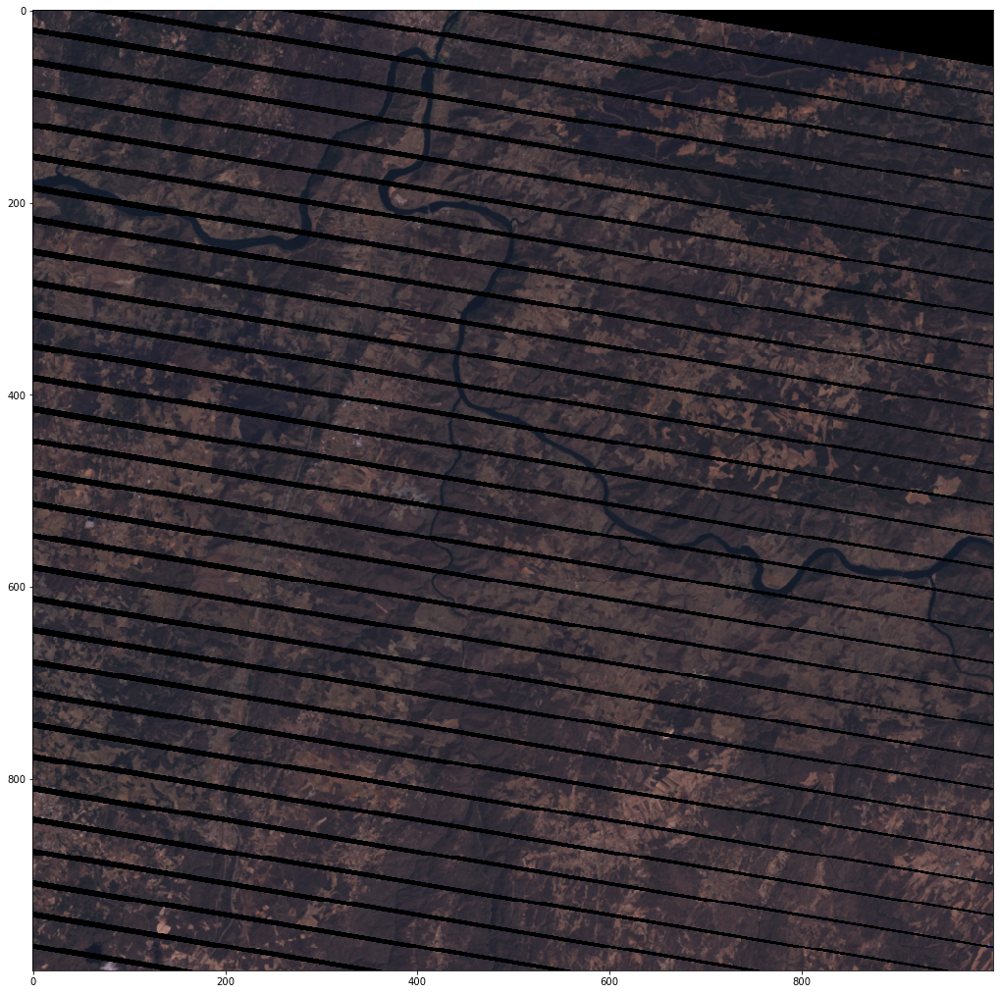

Full Image
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170803_20170829_01_T1\LE07_L1TP_203032_20170803_20170829_01_T1_B1.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170803_20170829_01_T1\LE07_L1TP_203032_20170803_20170829_01_T1_B2.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170803_20170829_01_T1\LE07_L1TP_203032_20170803_20170829_01_T1_B3.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170803_20170829_01_T1\LE07_L1TP_203032_20170803_20170829_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8081, 'height': 7071, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 555885.0,
       0.0, -30.0, 4573215.0)}


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


0 8081 0 7071


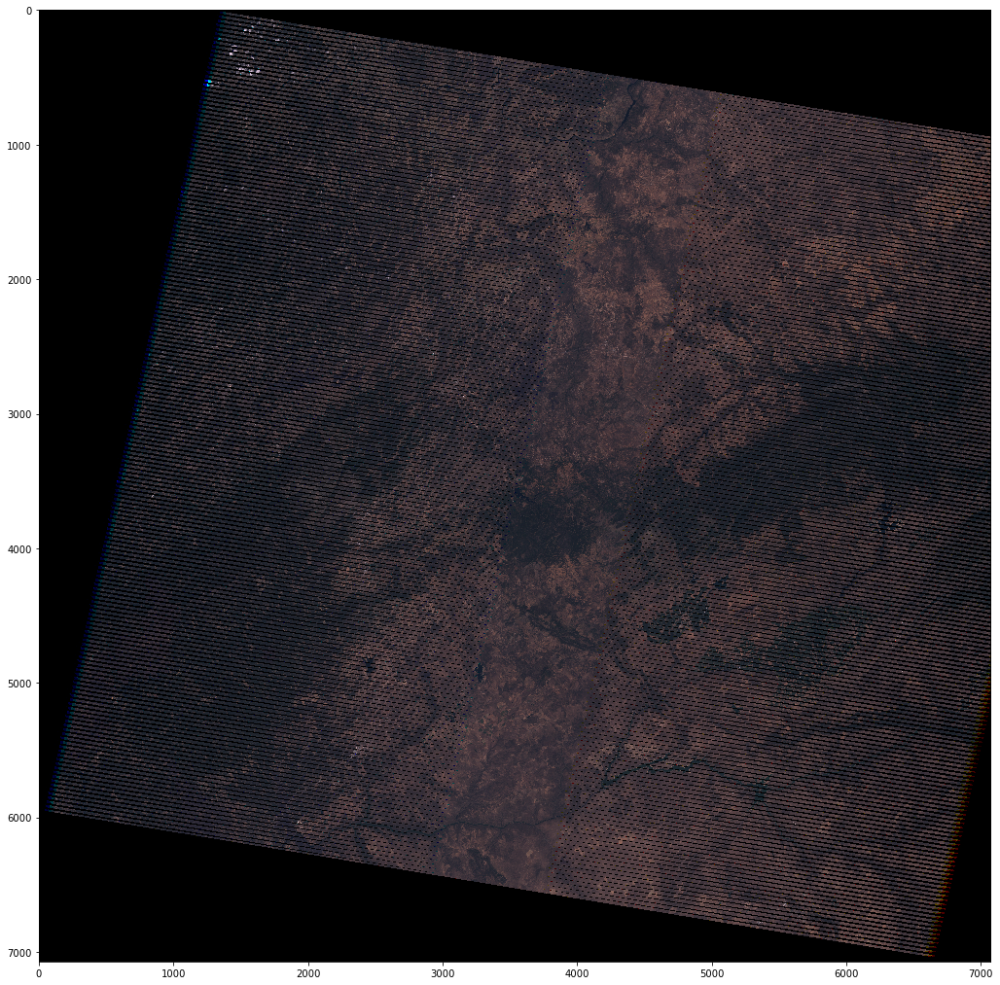



->>>>>>>>>>>>>>>>>> 10    LE07_L1TP_203032_20170819_20170914_01_T1       Image 2  of  4   

 
Zoomed!
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170819_20170914_01_T1\LE07_L1TP_203032_20170819_20170914_01_T1_B1.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170819_20170914_01_T1\LE07_L1TP_203032_20170819_20170914_01_T1_B2.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170819_20170914_01_T1\LE07_L1TP_203032_20170819_20170914_01_T1_B3.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170819_20170914_01_T1\LE07_L1TP_203032_20170819_20170914_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8091, 'height': 7101, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 556485.0,
       0.0, -30.0, 4573515.0)}


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


365 1365 3010 4010


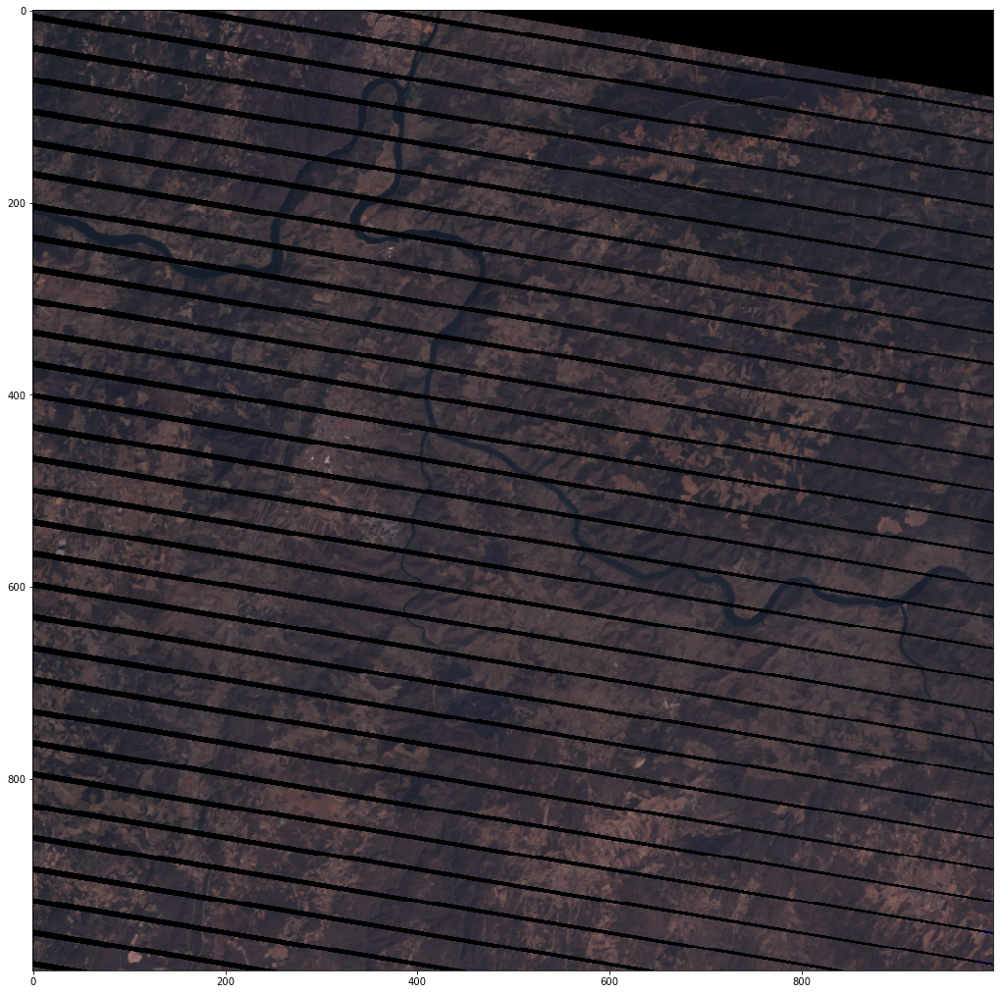

Full Image
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170819_20170914_01_T1\LE07_L1TP_203032_20170819_20170914_01_T1_B1.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170819_20170914_01_T1\LE07_L1TP_203032_20170819_20170914_01_T1_B2.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170819_20170914_01_T1\LE07_L1TP_203032_20170819_20170914_01_T1_B3.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170819_20170914_01_T1\LE07_L1TP_203032_20170819_20170914_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8091, 'height': 7101, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 556485.0,
       0.0, -30.0, 4573515.0)}


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


0 8091 0 7101


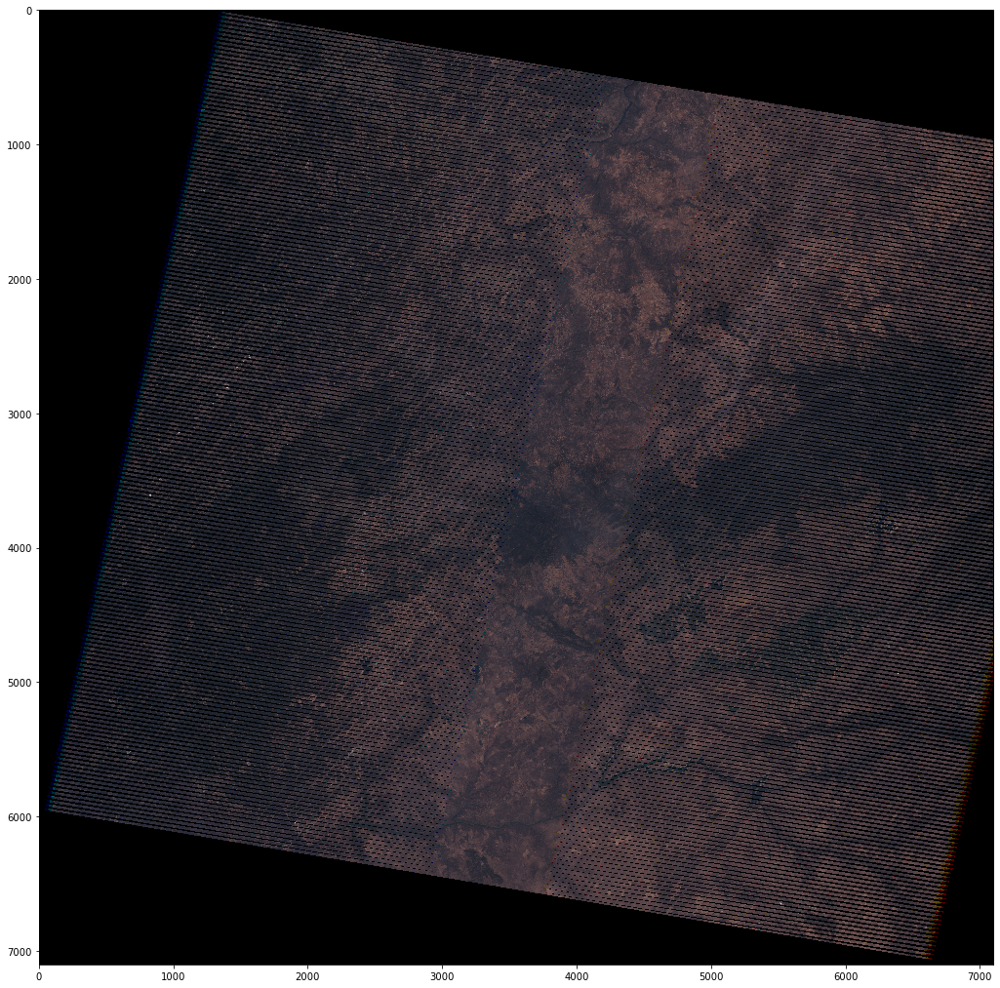



->>>>>>>>>>>>>>>>>> 10    LE07_L1TP_204032_20170810_20170905_01_T1       Image 3  of  4   

 
Zoomed!
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170810_20170905_01_T1\LE07_L1TP_204032_20170810_20170905_01_T1_B1.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170810_20170905_01_T1\LE07_L1TP_204032_20170810_20170905_01_T1_B2.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170810_20170905_01_T1\LE07_L1TP_204032_20170810_20170905_01_T1_B3.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170810_20170905_01_T1\LE07_L1TP_204032_20170810_20170905_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8171, 'height': 7191, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 424185.0,
       0.0, -30.0, 4573215.0)}


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


4775 5775 3000 4000


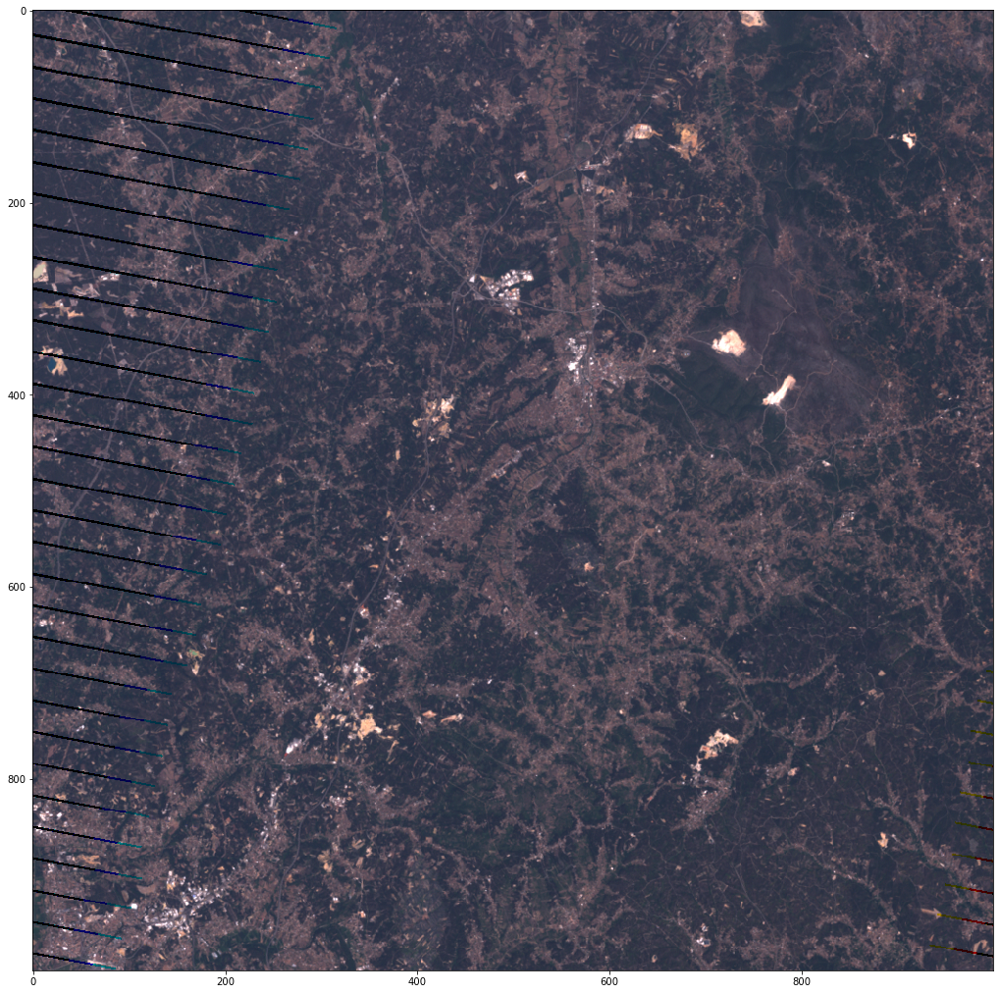

Full Image
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170810_20170905_01_T1\LE07_L1TP_204032_20170810_20170905_01_T1_B1.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170810_20170905_01_T1\LE07_L1TP_204032_20170810_20170905_01_T1_B2.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170810_20170905_01_T1\LE07_L1TP_204032_20170810_20170905_01_T1_B3.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170810_20170905_01_T1\LE07_L1TP_204032_20170810_20170905_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8171, 'height': 7191, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 424185.0,
       0.0, -30.0, 4573215.0)}


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


0 8171 0 7191


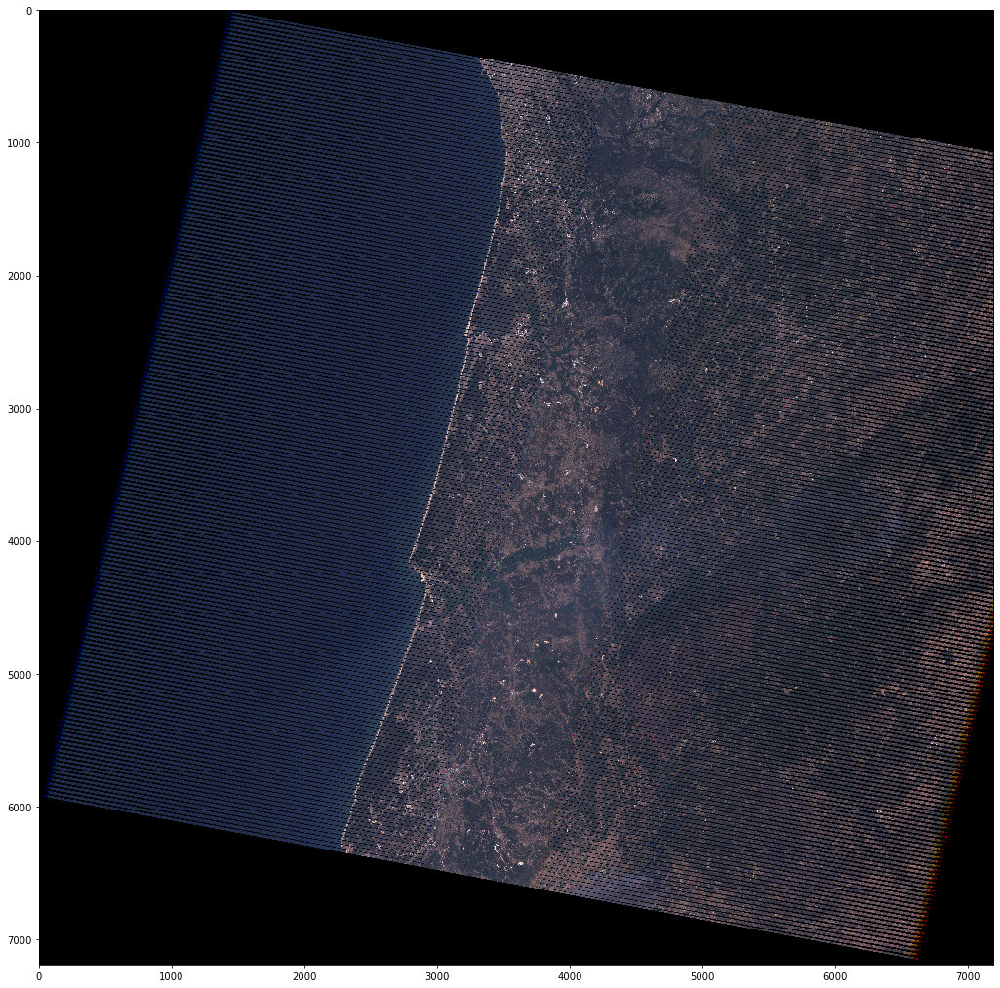



->>>>>>>>>>>>>>>>>> 10    LE07_L1TP_204032_20170826_20170921_01_T1       Image 4  of  4   

 
Zoomed!
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170826_20170921_01_T1\LE07_L1TP_204032_20170826_20170921_01_T1_B1.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170826_20170921_01_T1\LE07_L1TP_204032_20170826_20170921_01_T1_B2.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170826_20170921_01_T1\LE07_L1TP_204032_20170826_20170921_01_T1_B3.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170826_20170921_01_T1\LE07_L1TP_204032_20170826_20170921_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8171, 'height': 7191, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 423885.0,
       0.0, -30.0, 4573215.0)}


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


4785 5785 3000 4000


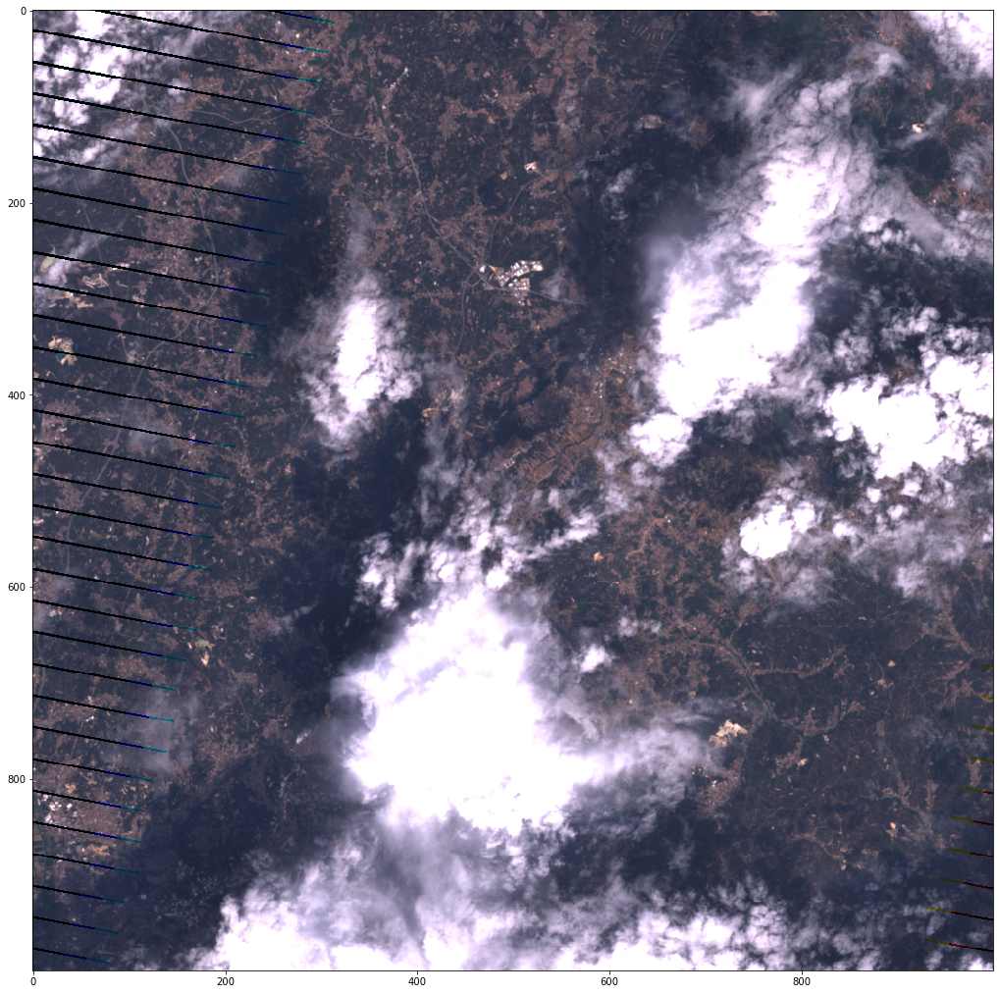

Full Image
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170826_20170921_01_T1\LE07_L1TP_204032_20170826_20170921_01_T1_B1.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170826_20170921_01_T1\LE07_L1TP_204032_20170826_20170921_01_T1_B2.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170826_20170921_01_T1\LE07_L1TP_204032_20170826_20170921_01_T1_B3.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170826_20170921_01_T1\LE07_L1TP_204032_20170826_20170921_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8171, 'height': 7191, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 423885.0,
       0.0, -30.0, 4573215.0)}


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


0 8171 0 7191


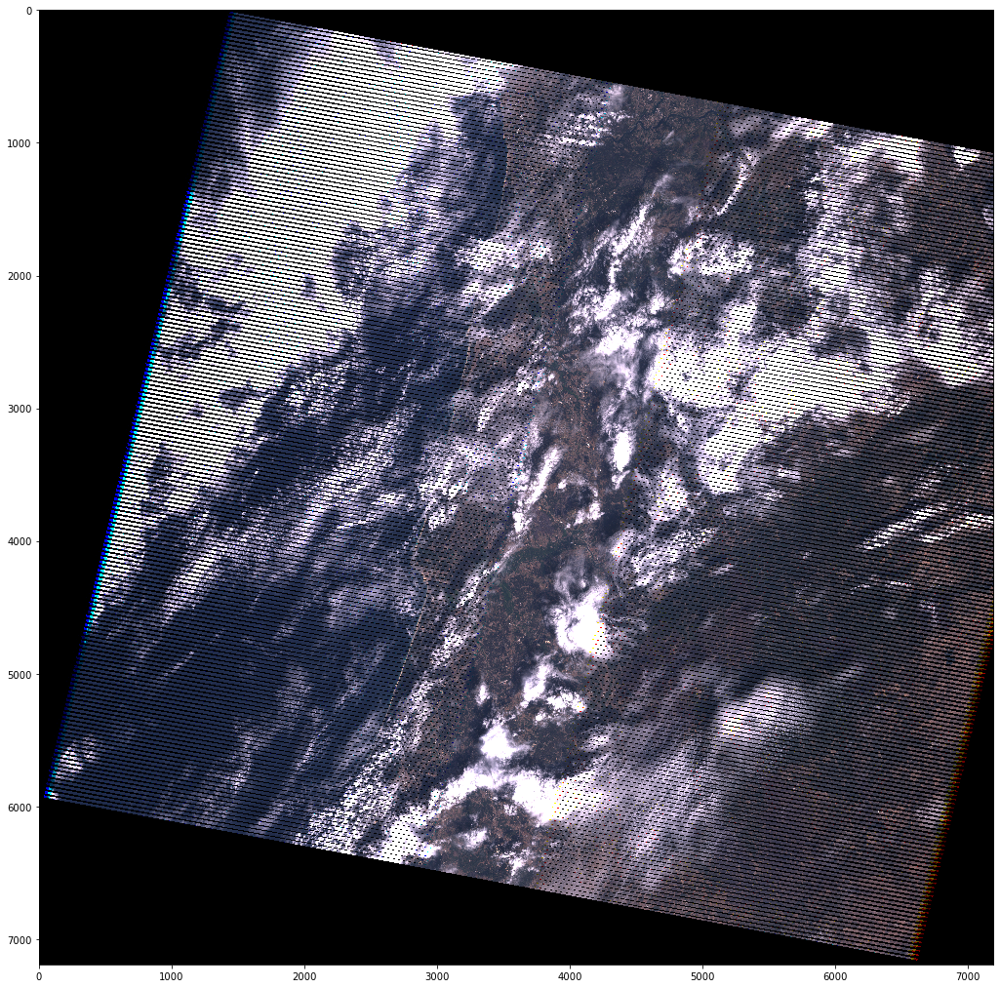

In [17]:
indexs = os.listdir("../../Satellite_img_before_2017/")
n=0
for index in indexs :
    path = "../../Satellite_img_before_2017/"+ index
    images_ids = os.listdir(path) # images founded for index choosen
    for image_id in images_ids :
        n= n + 1 
        print("\n\n->>>>>>>>>>>>>>>>>>", index,"  " ,image_id, "      Image", n ," of " , num_imgs ,"  \n\n " )
        lat = fires.loc[int(index)]["lat"]
        lon = fires.loc[int(index)]["lon"]
        print("Zoomed!")
        si.image_true_color_landsat(index,image_id ,"../../Satellite_img_before_2017/",lon,lat,500)
        print("Full Image")
        si.image_true_color_landsat(index,image_id ,"../../Satellite_img_before_2017/")
        

### Potential fires seen

../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170803_20170829_01_T1\LE07_L1TP_203032_20170803_20170829_01_T1_B1.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170803_20170829_01_T1\LE07_L1TP_203032_20170803_20170829_01_T1_B2.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170803_20170829_01_T1\LE07_L1TP_203032_20170803_20170829_01_T1_B3.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170803_20170829_01_T1\LE07_L1TP_203032_20170803_20170829_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8081, 'height': 7071, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 555885.0,
       0.0, -30.0, 4573215.0)}
385 1385 

C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


3000 4000


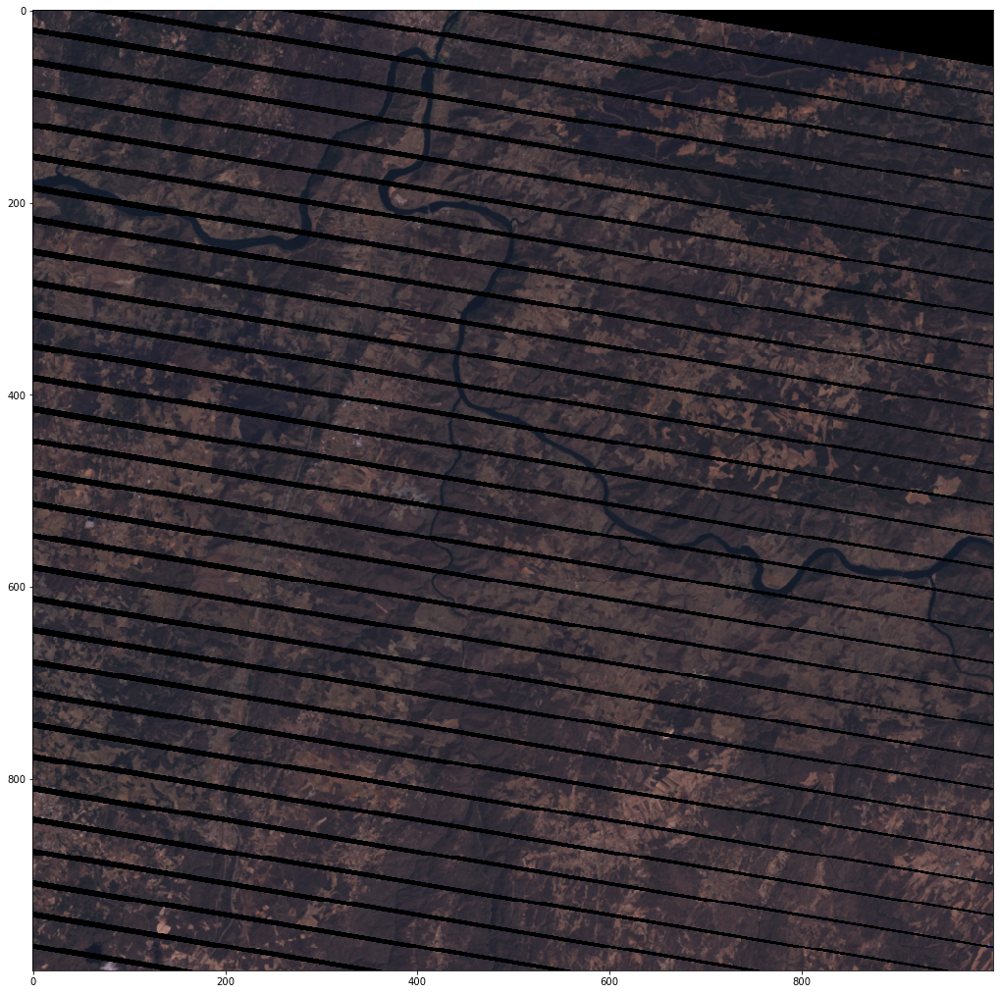

../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170819_20170914_01_T1\LE07_L1TP_203032_20170819_20170914_01_T1_B1.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170819_20170914_01_T1\LE07_L1TP_203032_20170819_20170914_01_T1_B2.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170819_20170914_01_T1\LE07_L1TP_203032_20170819_20170914_01_T1_B3.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_203032_20170819_20170914_01_T1\LE07_L1TP_203032_20170819_20170914_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8091, 'height': 7101, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 556485.0,
       0.0, -30.0, 4573515.0)}
365 1365 3010 4010


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


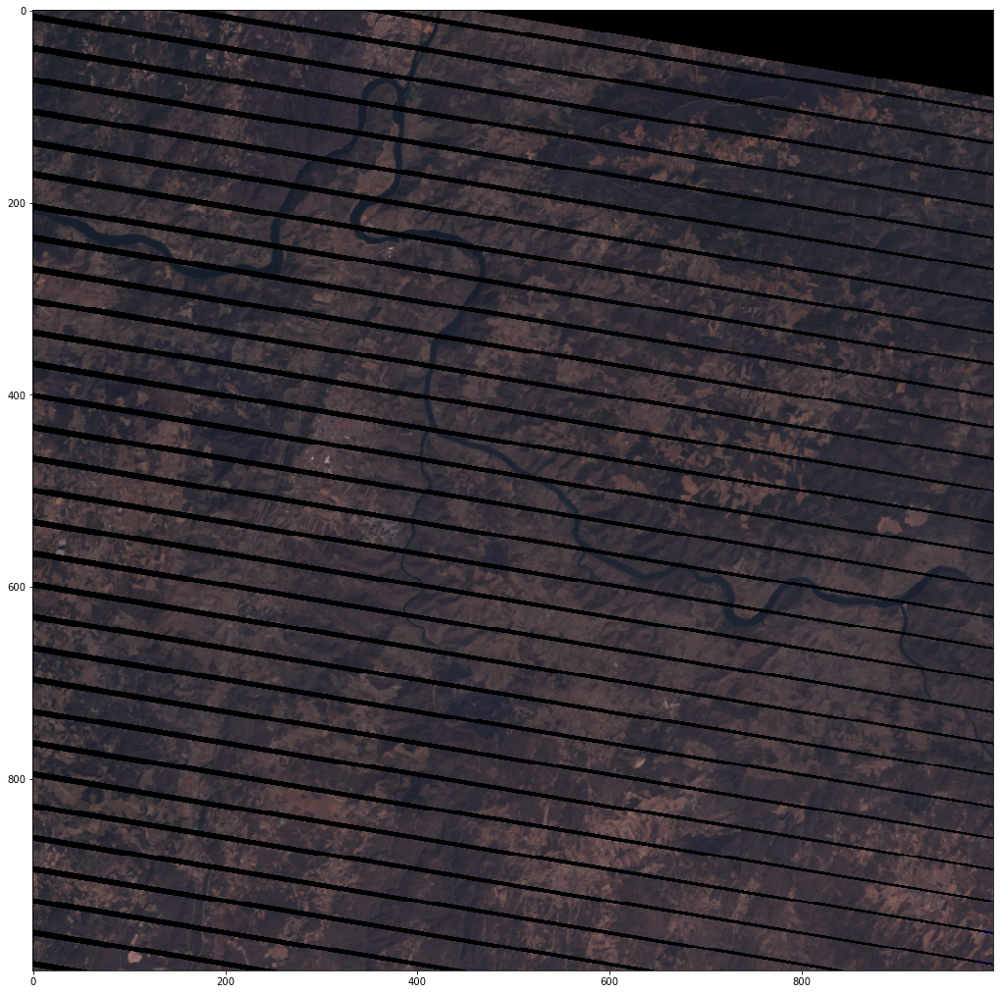

../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170810_20170905_01_T1\LE07_L1TP_204032_20170810_20170905_01_T1_B1.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170810_20170905_01_T1\LE07_L1TP_204032_20170810_20170905_01_T1_B2.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170810_20170905_01_T1\LE07_L1TP_204032_20170810_20170905_01_T1_B3.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170810_20170905_01_T1\LE07_L1TP_204032_20170810_20170905_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8171, 'height': 7191, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 424185.0,
       0.0, -30.0, 4573215.0)}
4775 5775 3000 4000


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


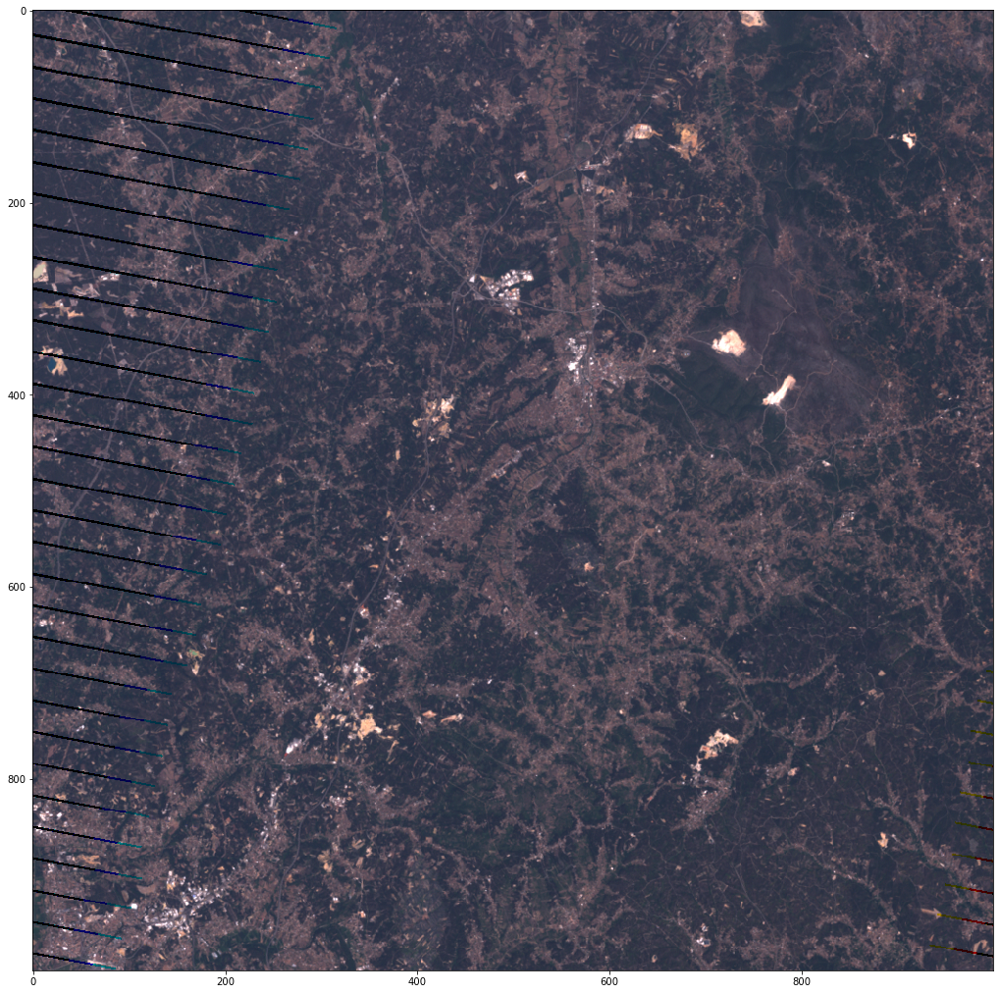

../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170826_20170921_01_T1\LE07_L1TP_204032_20170826_20170921_01_T1_B1.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170826_20170921_01_T1\LE07_L1TP_204032_20170826_20170921_01_T1_B2.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170826_20170921_01_T1\LE07_L1TP_204032_20170826_20170921_01_T1_B3.TIF
../../Satellite_img_before_2017/10/LE07_L1TP_204032_20170826_20170921_01_T1\LE07_L1TP_204032_20170826_20170921_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8171, 'height': 7191, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 423885.0,
       0.0, -30.0, 4573215.0)}
4785 5785 3000 4000


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


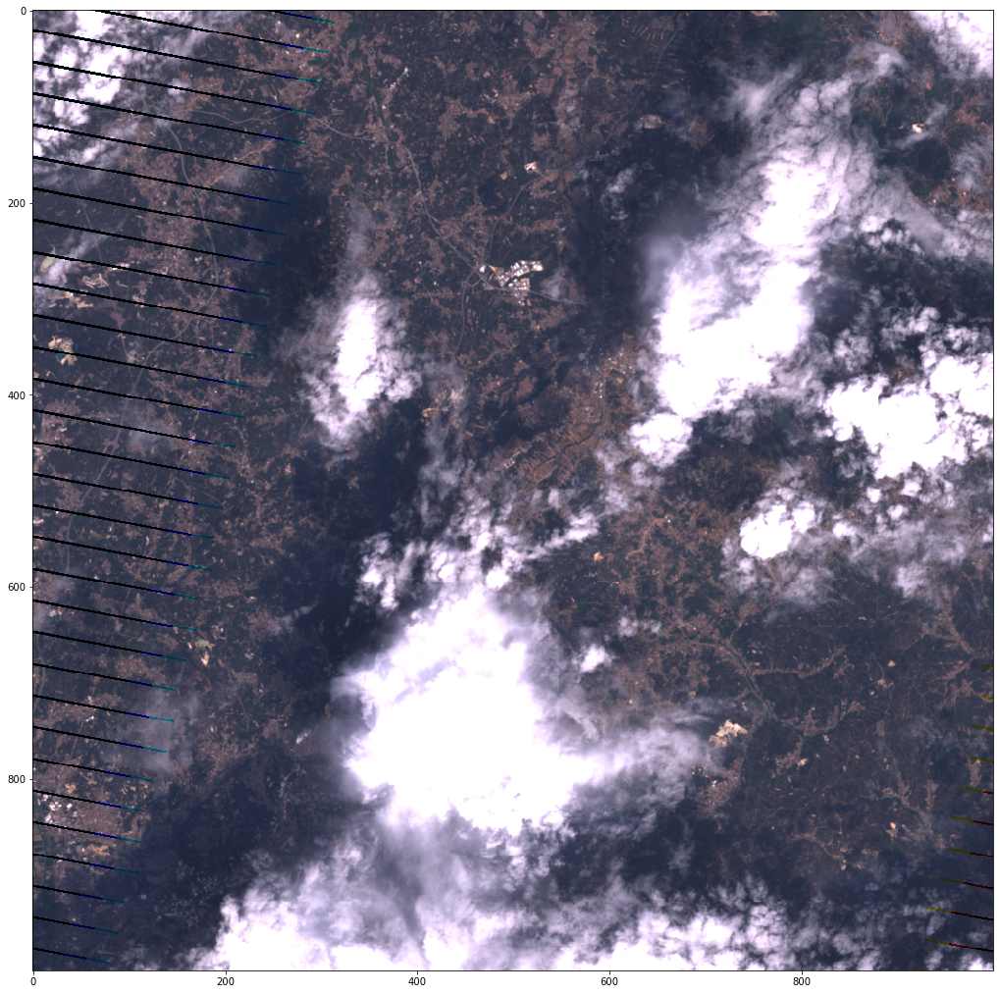

In [20]:
# +lon cima
# +lat direita
indexs = os.listdir("../../Satellite_img_before_2017/")
n=0
potentials = [ 10 , 11 , 14 , 24 , 5 , 9 ]
for index in indexs :
    path = "../../Satellite_img_before_2017/"+ index
    if float(index) in potentials :
        images_ids = os.listdir(path) # images founded for index choosen
        for image_id in images_ids :
            n= n + 1
            if (int(index) == 11) :
                lat_shift = -0.05
                lon_shift = 0.05
            if (int(index) == 10) :
                lat_shift = -0.00
                lon_shift = 0.00
            if (int(index) == 14) :
                lat_shift = -0.00
                lon_shift = 0.00
            if (int(index) == 24) :
                lat_shift = -0.05
                lon_shift = 0.00
            if (int(index) == 5) :
                lat_shift = -0.09
                lon_shift = 0.03
            if (int(index) == 9) :
                lat_shift = -0.00
                lon_shift = 0.00
            lat = (float(fires.loc[int(index)]["lat"]) + lat_shift )
            lon = (float(fires.loc[int(index)]["lon"]) + lon_shift )
        
            si.image_true_color_landsat(index,image_id ,"../../Satellite_img_before_2017/",lon,lat,500)
